# Synchronization of integrate-and-fire oscillators
#### V. Hunter Adams (vha3@cornell.edu)

In [284]:
import numpy
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [21, 7.77]
from IPython.core.display import HTML
from matplotlib import animation, rc
from IPython.display import HTML
from IPython.display import clear_output
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

***

## Integrate-and-fire oscillators

An integrate-and-fire oscillator is a system that integrates a function until some threshold value is reached, at which point the system "fires" and the integrator is reset to zero. An animation of such a system is shown below. These systems have been used to model neurons, pacemaker cells in hearts, and other biological systems that synchronize [1]. 

In [269]:
x = numpy.arange(0, 100, 1)

red_position  = 0

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(figsize=(21, 7.77))

ax.set_xlim((0, 100))
ax.set_ylim((-1, 11))
ann = ax.annotate("firing threshold", xy=(1, 10.1), xytext=(1, 10.1), fontsize=18)
ax.set_title('An integrate-and-fire oscillator', fontsize=28)
ax.set_xlabel('time', fontsize=18)
ax.set_ylabel('$\sqrt{time}$', fontsize=18)
ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])


line,  = ax.plot(x, numpy.sqrt(x))
line1, = ax.plot([],[], 'r.', alpha=0.7, markersize=30)
line2, = ax.plot(x, numpy.ones(len(x))*10, 'b--', linewidth=0.5)


# initialization function: plot the background of each frame
def init():
    line.set_data(x, numpy.sqrt(x))
    line1.set_data(x[red_position], [numpy.sqrt(x[red_position])])
    line2.set_data(x, numpy.ones(len(x))*10)
    
    return (line, line1, line2, )


def animate(i):
    line.set_data(x, numpy.sqrt(x))
    line2.set_data(x, numpy.ones(len(x))*10)
    
    global red_position
    
    red_position = (red_position + 1)%100
        
    line1.set_data([x[red_position]], [numpy.sqrt(x[red_position])])
    return (line, line1, line2, )

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=100, interval=20, blit=True)
rc('animation', html='jshtml')

plt.close()

In [270]:
anim

## Synchronization algorithm

Under certain conditions, populations of integrate-and-fire oscillators will synchronize. The oscillators must rise toward their firing threshold on a curve which is monotonic and concave down (on this webpage, I use $y = \sqrt{t}$, but any other curve that meets requirements would work). Furthermore, when a particular oscillator fires, all other oscillators are "pulled up" by an amount $\epsilon$ or are pulled up to their firing threshold, whichever is less. 

This is illustrated below. The red oscillator has reached its firing threshold and fired. The green oscillator detects this firing and is pulled up by an amount $\epsilon$. If this had pulled the oscillator above its firing threshold, then it too would have fired.

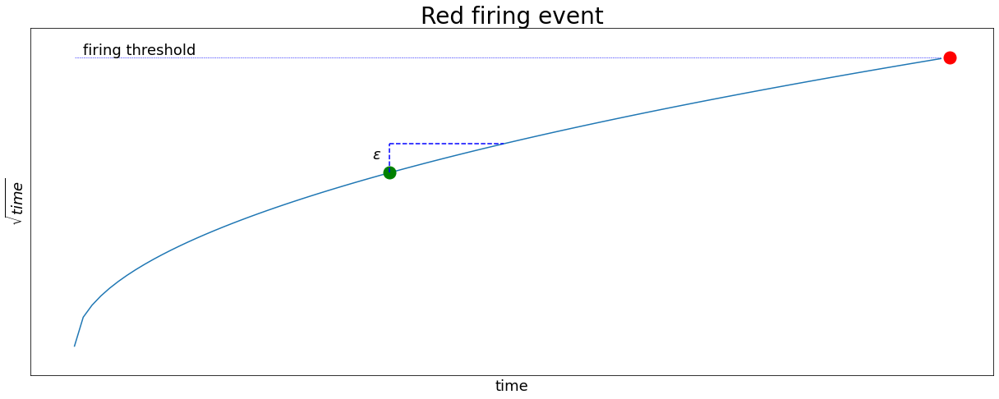

In [285]:
plt.plot(x, numpy.sqrt(x))
plt.ylim([-1, 11])
plt.plot([100],[10], 'r.', markersize=30)
plt.plot([36],[6], 'g.', markersize=30)
plt.plot(x, numpy.ones(len(x))*10, 'b--', lw=0.5)
plt.plot([36, 36], [6, 7], 'b--')
plt.plot([36, 49], [7, 7], 'b--')
plt.annotate("$\epsilon$", xy=(34, 6.5), xytext=(34, 6.5), fontsize=18)
plt.annotate("firing threshold", xy=(1, 10.1), xytext=(1, 10.1), fontsize=18)
plt.title("Red firing event", fontsize=28)
plt.xlabel('time', fontsize=18)
plt.ylabel('$\sqrt{time}$', fontsize=18)
plt.xticks([])
plt.yticks([])

plt.show()

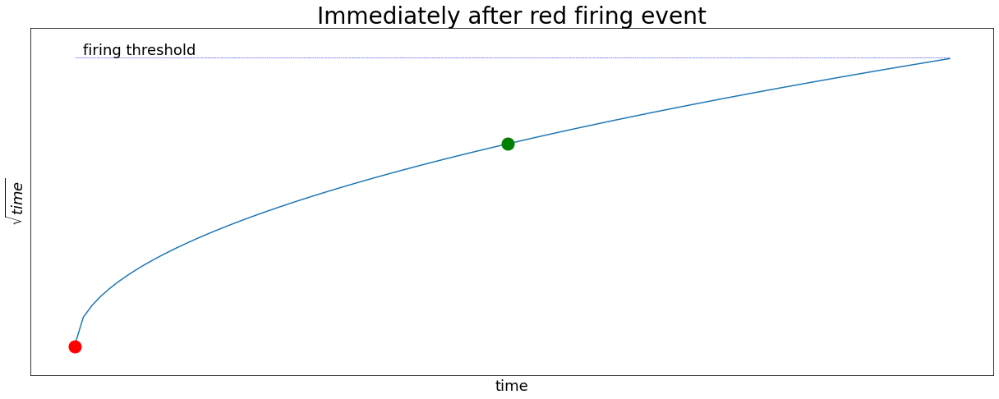

In [286]:
plt.plot(x, numpy.sqrt(x))
plt.ylim([-1, 11])
plt.plot([0],[0], 'r.', markersize=30)
plt.plot([49],[7], 'g.', markersize=30)
plt.plot(x, numpy.ones(len(x))*10, 'b--', lw=0.5)
plt.annotate("firing threshold", xy=(1, 10.1), xytext=(1, 10.1), fontsize=18)
plt.title("Immediately after red firing event", fontsize=28)
plt.xlabel('time', fontsize=18)
plt.ylabel('$\sqrt{time}$', fontsize=18)
plt.xticks([])
plt.yticks([])

plt.show()

## Implementing the algorithm on a microcontroller

There are at least three ways to implement this algorithm. Each involves tradeoffs of memory utilization vs. computational expense.

#### Numeric integration
1. Setup a timer interrupt.
2. Numerically integrate a concave-down function one timestep each time thru the interrupt.
3. If the integrated value exceeds the firing threshold, execute a fire event and zero the integrator.
4. If a fire event is detected, add $\epsilon$ to the integrated value, execute a fire event if that causes the integrated value to exceed the firing threshold.

#### Calculation-on-event
1. Setup a timer interrupt
2. Increment a counting variable each time thru the interrupt.
3. If that counting variable exceeds the x-value which yields the firing threshold for the concave-down firing curve, execute a fire event and zero the counter.
4. If a fire event is detected, use the counting variable to compute your current y-position on the firing curve, add $\epsilon$, and then solve for the updated value of the counting variable by inverting the concave-down firing curve. If the new value of the counting variable exceeds the x-value which yields the firing threshold for the concave-down firing curve, execute a fire event and zero the counter.

#### Lookup table

1. Setup a timer interrupt.
2. Increment a counting variable each time thru the interrupt.
4. If the counting variable exceeds the x-value which yields the firing threshold for the concave-down firing curve, execute a fire event and zero the counter.
5. If a fire event is detected, use the value of the counting variable to index into a lookup table which contains the amount by which the counting variable should be incremented for each possible value of the counting variable. If the new value of the counting variable exceeds the firing threshold, execute a fire event and zero the counter.

## Synchronization demonstrations

In [279]:
x = numpy.arange(0, 100, 1)

red_position  = 0
blue_position = 40
green_position = 75

epsilon = 1.48

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(figsize=(21, 7.77))

ax.set_xlim((0, 100))
ax.set_ylim((0, 11))

ann = ax.annotate("firing threshold", xy=(1, 10.1), xytext=(1, 10.1), fontsize=18)

ax.set_title('Synchronization of pulse-coupled oscillators', fontsize=28)
ax.set_xlabel('time', fontsize=18)
ax.set_ylabel('$\sqrt{time}$', fontsize=18)
ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])


line,  = ax.plot(x, numpy.sqrt(x))
line1, = ax.plot([],[], 'r.', alpha=0.7, markersize=30)
line2, = ax.plot([],[], 'b.', alpha=0.7, markersize=30)
line3, = ax.plot([],[], 'g.', alpha=0.7, markersize=30)
line4, = ax.plot(x, numpy.ones(len(x))*10, 'b--', linewidth=0.5)


# initialization function: plot the background of each frame
def init():
    line.set_data(x, numpy.sqrt(x))
    line1.set_data(x[red_position], [numpy.sqrt(x[red_position])])
    line2.set_data([x[blue_position]], [numpy.sqrt(x[blue_position])])
    line3.set_data([x[green_position]], [numpy.sqrt(x[green_position])])
    line4.set_data(x, numpy.ones(len(x))*10)
    
    return (line, line1, line2, line4, )


def animate(i):
    line.set_data(x, numpy.sqrt(x))
    
    global red_position
    global blue_position
    global green_position
    global epsilon
    
    red_position_new = (red_position + 1)%100
    blue_position_new = (blue_position + 1)%100
    green_position_new = (green_position + 1)%100
    
    if (red_position_new < red_position):
        if (blue_position_new > blue_position):
            blue_position_new = int((numpy.sqrt(float(blue_position_new)) + epsilon)**2.)
            if (blue_position_new > 100):
                blue_position_new = 0
        if (green_position_new > green_position):
            green_position_new = int((numpy.sqrt(float(green_position_new)) + epsilon)**2.)
            if (green_position_new > 100):
                green_position_new = 0
        
    elif (blue_position_new < blue_position):
        if (red_position_new > red_position):
            red_position_new = int((numpy.sqrt(float(red_position_new)) + epsilon)**2.)
            if (red_position_new > 100):
                red_position_new = 0
        if (green_position_new > green_position):
            green_position_new = int((numpy.sqrt(float(green_position_new)) + epsilon)**2.)
            if (green_position_new > 100):
                green_position_new = 0
                
    elif (green_position_new < green_position):
        if (red_position_new > red_position):
            red_position_new = int((numpy.sqrt(float(red_position_new)) + epsilon)**2.)
            if (red_position_new > 100):
                red_position_new = 0
        if (blue_position_new > blue_position):
            blue_position_new = int((numpy.sqrt(float(blue_position_new)) + epsilon)**2.)
            if (blue_position_new > 100):
                blue_position_new = 0
        
    red_position = red_position_new
    blue_position = blue_position_new
    green_position = green_position_new
        
    line1.set_data([x[red_position]], [numpy.sqrt(x[red_position])])
    line2.set_data([x[blue_position]], [numpy.sqrt(x[blue_position])])
    line3.set_data([x[green_position]], [numpy.sqrt(x[green_position])])
    line4.set_data(x, numpy.ones(len(x))*10)
    return (line, line1, line2, line3, line4, )

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=450, interval=20, blit=True)
rc('animation', html='jshtml')

plt.close()

### Software

In [280]:
anim

### Hardware

Synchronization via audio, using calculation-on-event:

<iframe width="560" height="315" src="https://www.youtube.com/embed/q39YzAHCquw" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

Synchronization via radio, using calculation-on-event:

<iframe width="560" height="315" src="https://www.youtube.com/embed/_-zkH7rmq8A?start=69" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

## References

1. [Mirollo, Renato E., and Steven H. Strogatz. "Synchronization of pulse-coupled biological oscillators." SIAM Journal on Applied Mathematics 50.6 (1990): 1645-1662.](./Sync.pdf)